In [1]:
import loompy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os, os.path
from scipy import sparse
import tomotopy as tt

# suppress INFO
import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

# Model Topics

In [ ]:
k = 35
modelsrc = 'Recombined3Clean2_C_FBPC' #Fibroblasts_pericytes
tp_attr = "TP_%s_%s" % (k, modelsrc)
model = tt.LDAModel.load('HumanAdult_Recombined3Clean2_C_FBPC_35topics_model.bin')
cells = np.loadtxt('HumanAdult_Recombined3Clean2_C_FBPC_35topics_cells.txt').astype('int')
transformed = np.vstack([doc.get_topic_dist() for doc in model.docs])
print(transformed.shape)

In [ ]:
# List the most contributing genes in each topic:
e2g = { v:k for k,v in [l.strip().split('\t') for l in open("/data/ref/Hs/genename2ensg.tab")] }
for i in range(k):
    print("Topic %s:" % i)
    topicwords = model.get_topic_words(i, top_n=5)
    for t in topicwords:
        g = e2g[t[0]] if t[0] in e2g else t[0]
        print("%8s:%.4f" % (g,t[1]), end=" ")
    print()

# Xenium data

In [ ]:
afolder = '/proj/meninges/Topic_modelling'
adata_loom = f'{afolder}/adata_meningioma.loom'
outfolder = afolder + '/' + modelsrc + '/' + str(k)
import os
os.makedirs(outfolder, exist_ok=True)

tp_attr = "TP_%s_%s" % (k, modelsrc)

with loompy.connect(adata_loom, 'r') as ds:
    if tp_attr in ds.ca:
        adata_transformed = ds.ca[tp_attr]
    else:
        print("Shape of %s: %s" % (adata_loom, ds.shape))
        # If Accessions are missing, we need to use a translation table from Gene name to Accessions (ENSGxxx)
        if 'Accession' in ds.ra:
            adata_accessions = np.array(ds.ra.Accession[:])
        else:
            g2e = { k:v for k,v in [l.strip().split('\t') for l in open("genename2ensg.tab")] }
            adata_accessions = np.array([ g2e[k] for k in ds.ra.Gene ])
        # use only genes in the pre-fit model
        selected_genes = pd.Series(adata_accessions).isin(list(model.vocabs)).to_numpy()
        selected_genes = np.where(selected_genes)[0]
        print("# selected genes: %s" % len(selected_genes))
        data = ds.sparse(rows=selected_genes).A
        # construct corpus
        n_cells = ds.shape[1]
        corpus = tt.utils.Corpus()
        [ corpus.add_doc( list(np.repeat(adata_accessions[selected_genes], data[:, i].astype('int').T, axis=0)) ) 
            for i in range(n_cells) ]
        adata_transformed = model.infer(corpus, together=False)[0]
        adata_transformed = np.vstack([doc.get_topic_dist() for doc in adata_transformed])
        print(adata_transformed.shape)
        # Save topic loading for later quick access:
        ds.ca[tp_attr] = adata_transformed
        print("Corpus done.")

In [10]:
with loompy.connect(adata_loom,'r') as ds:
    print(ds.ca.TP_35_Recombined3Clean2_C_FBPC)

[[0.00043807 0.00163892 0.00033761 ... 0.00030435 0.00040468 0.00042066]
 [0.00043112 0.00161291 0.00033226 ... 0.00029952 0.00039825 0.00041399]
 [0.01604716 0.00158771 0.00032706 ... 0.00029484 0.00039203 0.00040752]
 ...
 [0.0004584  0.00171498 0.00035328 ... 0.00031847 0.00042346 0.00044018]
 [0.00043456 0.00162581 0.00033491 ... 0.00030191 0.00040144 0.0004173 ]
 [0.00046034 0.00595888 0.00035478 ... 0.00879309 0.00042525 0.00044205]]


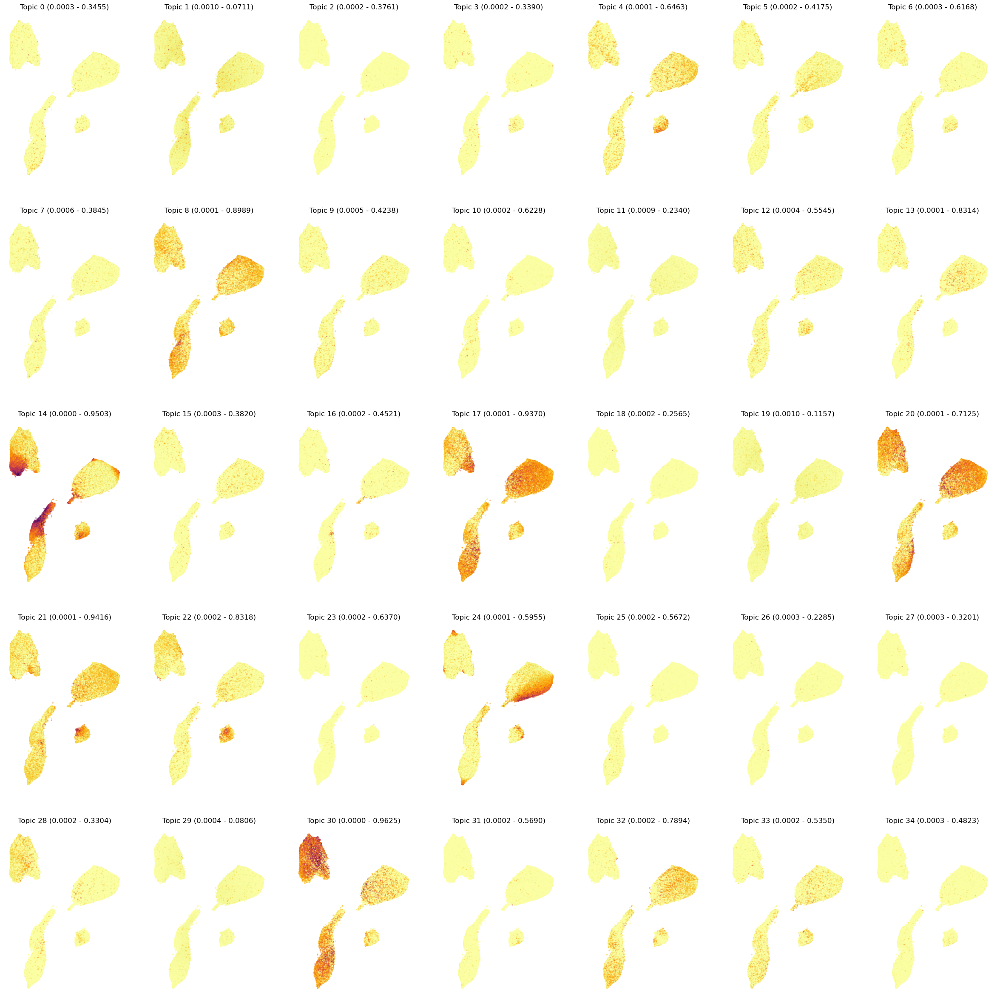

In [6]:
# Colorize the UMAP with the loading of each topic on the cells, here meningioma spatial data UMAP
plt.figure(None, (30, 30), facecolor='white')
gs = plt.GridSpec(5, k // 5)
with loompy.connect(adata_loom, 'r') as ds:
    for i in range(k):
        plt.subplot(gs[i])
        topicweights = adata_transformed[:,i]
        weights = topicweights / max(topicweights)
        plt.scatter(ds.ca.UMAP[:, 0], ds.ca.UMAP[:, 1], c=weights, alpha=0.5, s=5, lw=0, rasterized=True, cmap='inferno_r')
        plt.axis('off')
        plt.title("Topic %s (%.4f - %.4f)" % (i, min(topicweights), max(topicweights)), fontsize=12)
        plt.margins(0.05, 0.05)
#plt.savefig(Xenium_loadings_UMAP.png', dpi=300)
plt.show()

In [7]:
adata_loom = 'adata_meningioma.loom'
with loompy.connect(adata_loom, 'r') as ds:
    print(set(ds.ca.replicate))

{'M89a', 'M73a', 'M46', 'M73b', 'M89b', 'M99'}


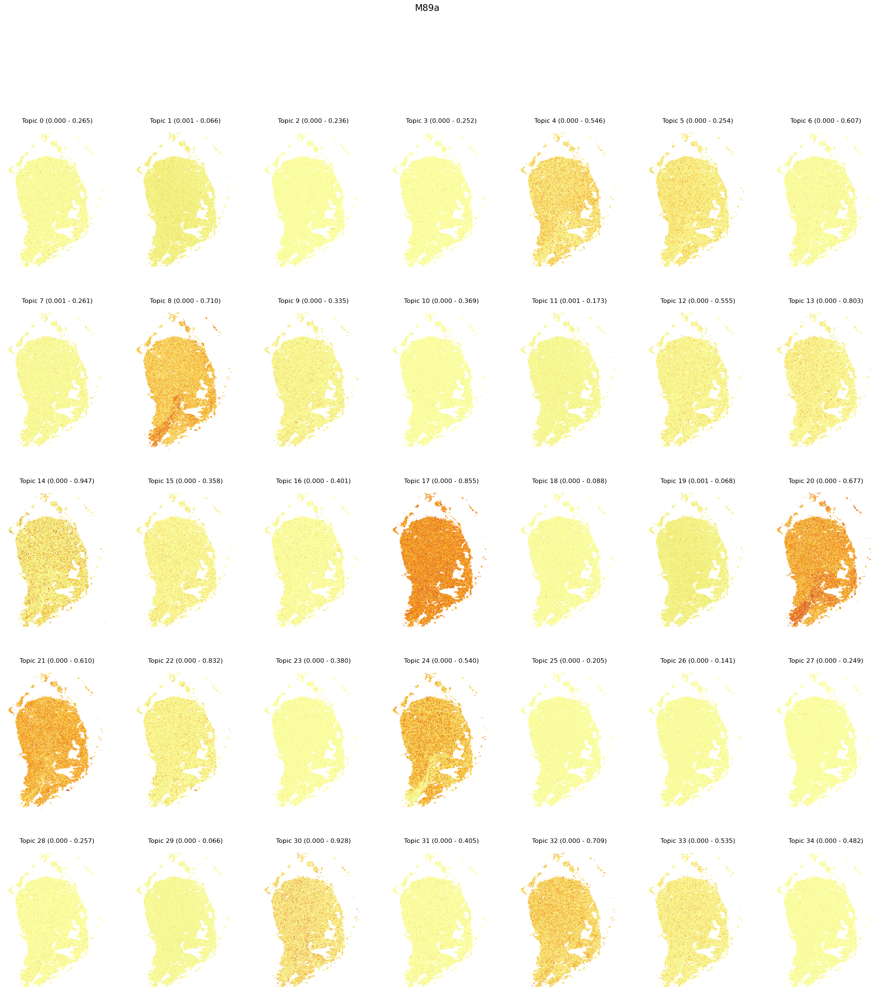

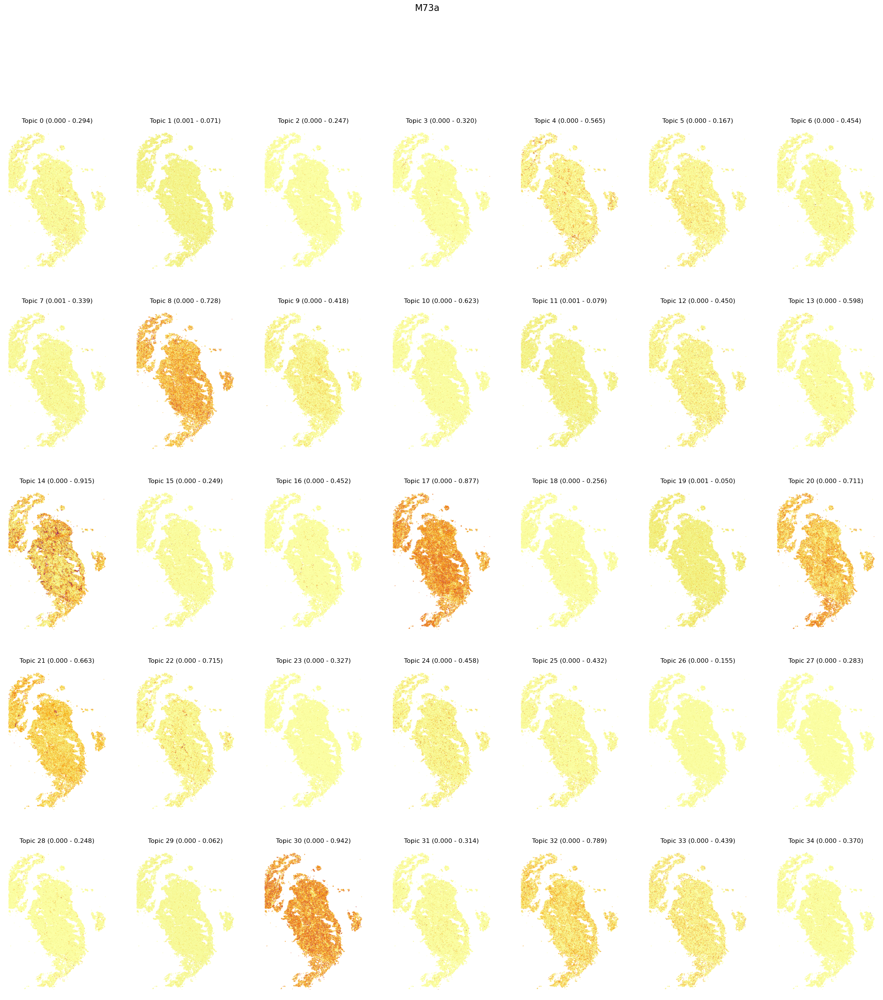

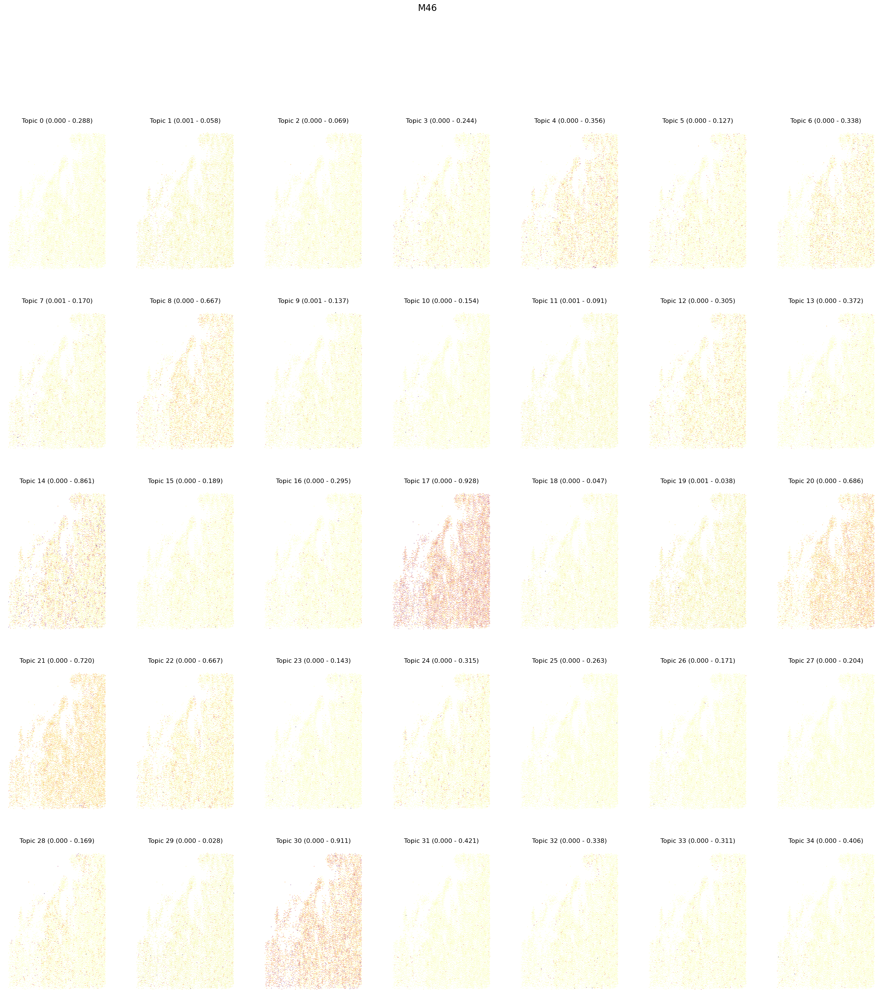

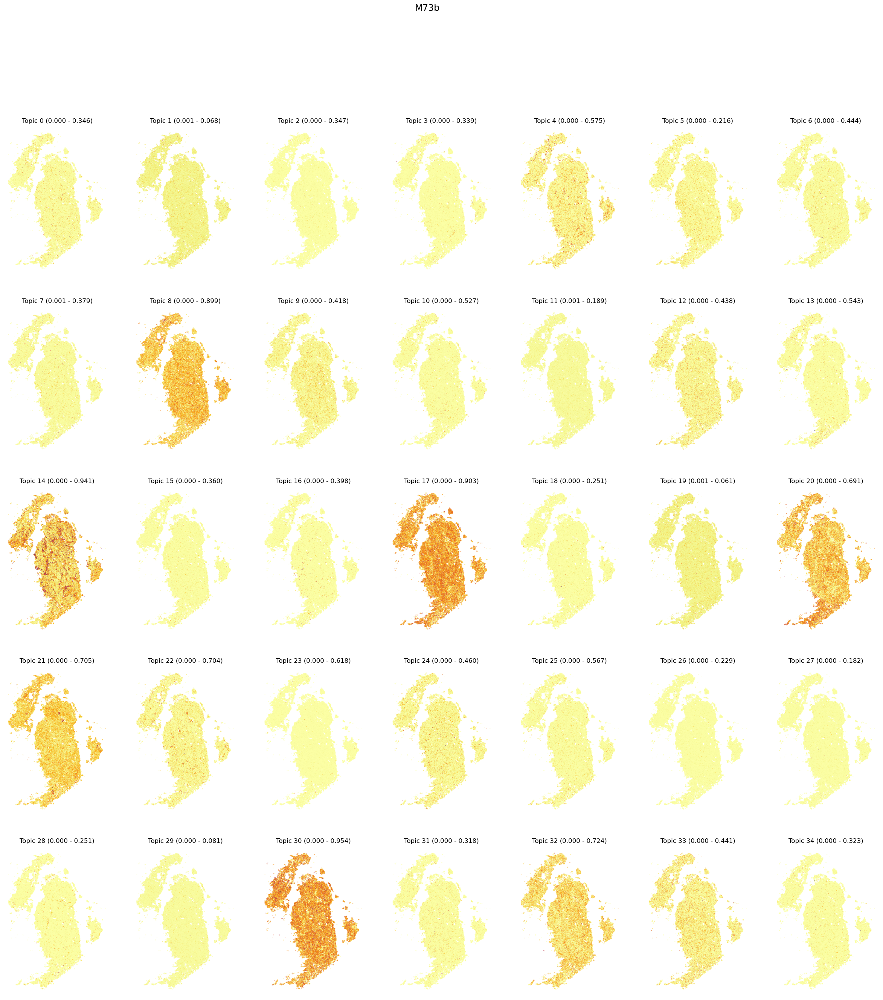

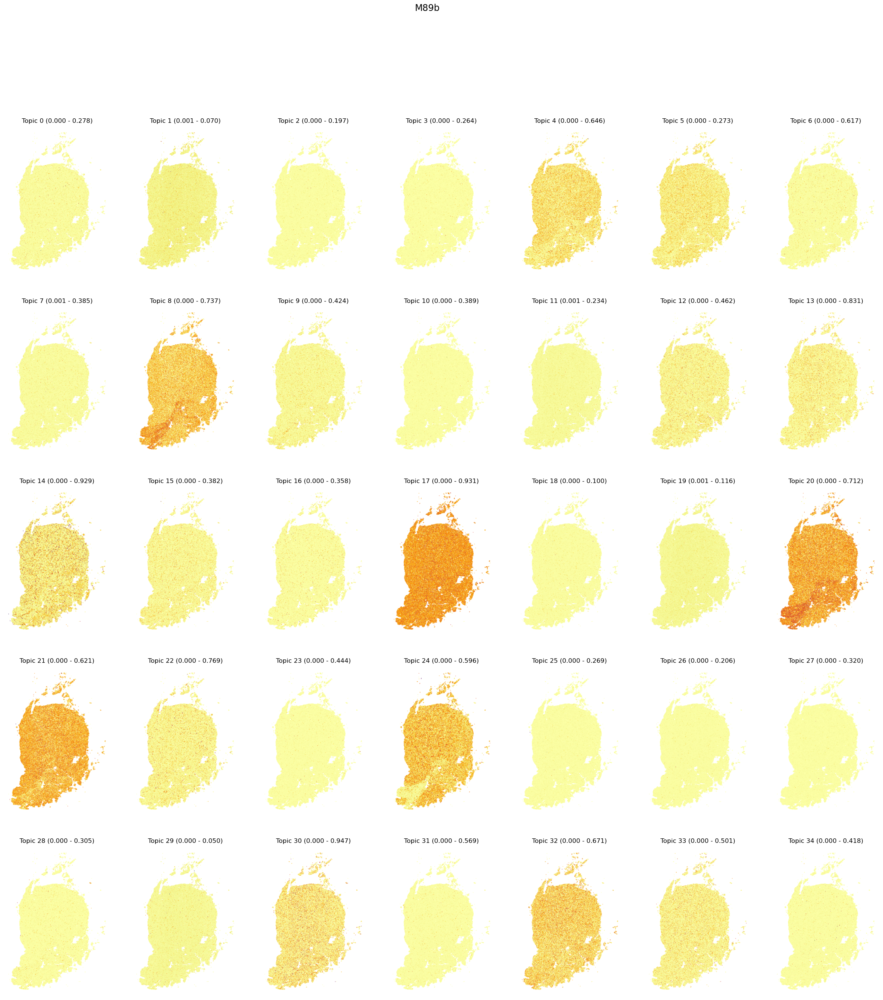

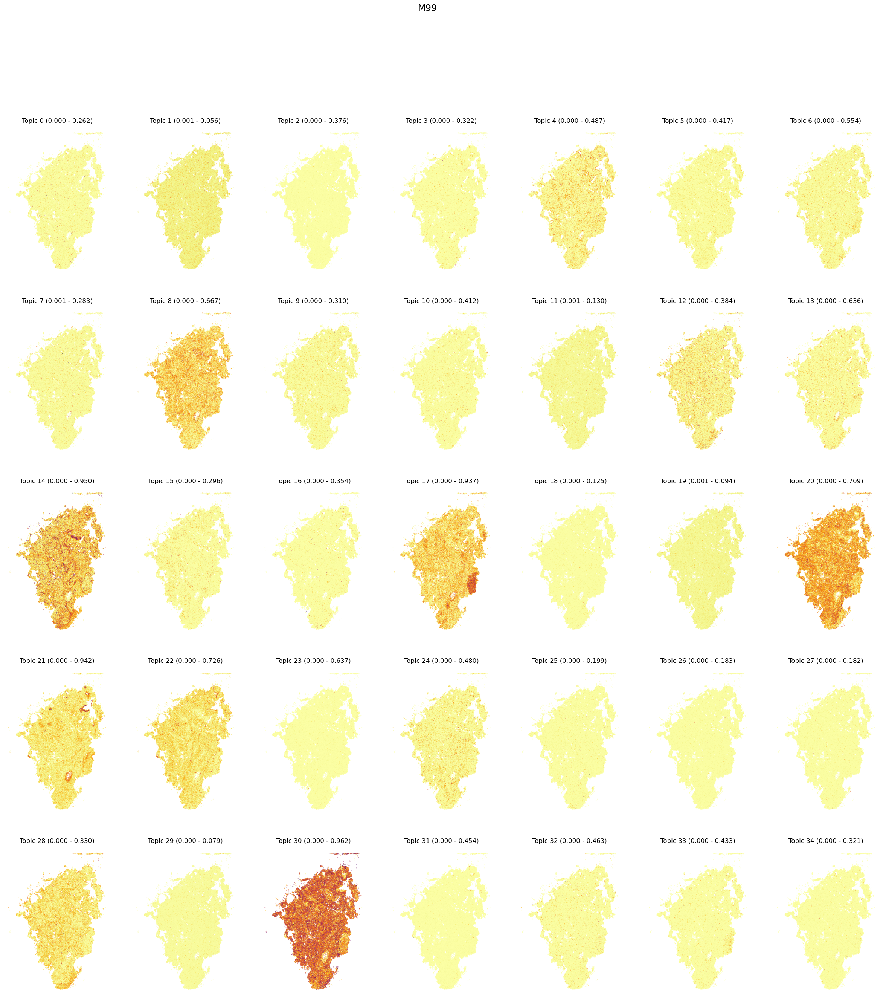

In [8]:
# Colorize the Xenium image with the loading of each topic on the cells
with loompy.connect(adata_loom, 'r') as ds:
    replicates = list(set(ds.ca.replicate))
    for replicate in replicates:
        fig = plt.figure(None, (30, 30), facecolor='white')
        gs = plt.GridSpec(5, k // 5)
        replicateidx = (ds.ca.replicate == replicate)
        xs = ds.ca.x_centroid[replicateidx]
        ys = ds.ca.y_centroid[replicateidx]
        for i in range(k):
            plt.subplot(gs[i])
            topicweights = adata_transformed[replicateidx,i]
            weights = topicweights / max(topicweights)
            plt.scatter(xs, ys, c=weights, alpha=0.5, s=2, lw=0, rasterized=True, cmap='inferno_r') #s=5
            plt.axis('off')
            plt.title("Topic %s (%.3f - %.3f)" % (i, min(topicweights), max(topicweights)), fontsize=12)
            plt.margins(0.05, 0.05)
        fig.suptitle(replicate, fontsize='xx-large', va='bottom')
        #plt.savefig(Xenium_%s_topics.png' % replicate, dpi=300)
        plt.show()

In [ ]:
# Save topic loading for later quick access:
with loompy.connect(adata_loom) as ds:
    tp_attr = "TP_%s_%s" % (k, modelsrc)
    ds.ca[tp_attr] = adata_transformed

# Infer topics to bulk RNA-seq from pre-trained model

In [4]:
# BULK RNA-SEQ

meningioma_loom = '/proj/meninges/Choudhury_meningioma.loom'

In [5]:
print("Processing " + meningioma_loom)
with loompy.connect(meningioma_loom, 'r') as ds:
    print("Shape of %s: %s" % (meningioma_loom, ds.shape))
    if 'Accession' in ds.ra:
        accessions = np.array(ds.ra.Accession[:])
    else:
        g2e = { k:v for k,v in [l.strip().split('\t') for l in open("/data/ref/Hs/genename2ensg.tab")] }
        accessions = np.array([ g2e[k] for k in ds.ra.Gene ])
    n_cells = ds.shape[1]
    # use only genes in the pre-fit model
    selected_genes = pd.Series(accessions).isin(list(model.vocabs)).to_numpy()
    selected_genes = np.where(selected_genes)[0]
    selected_genenames = accessions[selected_genes]
    
    if False:
        # choose n_cells from the set used for the paper
        selected_cells = np.random.choice(np.arange(ds.shape[1]), n_cells, replace=False)
        selected_cells = np.sort(selected_cells)
        data = ds.sparse(rows=selected_genes, cols=selected_cells).A
    else:
        data = ds.sparse(rows=selected_genes).A
    
    # construct corpus
    corpus = tt.utils.Corpus()
    [ corpus.add_doc( list(np.repeat(accessions[selected_genes], data[:, i].astype('int').T, axis=0)) ) 
        for i in range(n_cells) ]

Processing /proj/meninges/Choudhury_meningioma.loom
Shape of /proj/meninges/Choudhury_meningioma.loom: (33538, 185)


In [6]:
meningioma_transformed = model.infer(corpus, together=False)[0]
meningioma_transformed = np.vstack([doc.get_topic_dist() for doc in meningioma_transformed])
m = meningioma_transformed.T
ntopics, ntypes = m.shape

In [7]:
with loompy.connect(meningioma_loom, 'r') as ds:
    meningioma_ids = list(ds.ca.CellID)
print(meningioma_ids[:20])
print(len(meningioma_ids))
meningioma_meta = '/proj/meninges/Choudhury_Mxxx_Classes.csv'
from operator import itemgetter, attrgetter
metadata = [] # Columns are: mid, mtype, traf7, mening_histol, trans_histol
with open(meningioma_meta) as fd:
    header = fd.readline()
    for line in fd:
         metadata.append( line.rstrip().split('\t') )
# Sort by tumor type, then by ID
metadata_ordered = [ m for m in sorted(metadata, key=itemgetter(1,0)) if m[0] in meningioma_ids ]
# Get sort order of cells in loom file to match metadata type order:
mids_ordered = [ m[0] for m in metadata_ordered ]
loomorder = [ meningioma_ids.index(m) for m in mids_ordered]
tumortypes = np.array([m[1] for m in metadata_ordered])
uniquetumortypes = np.unique(tumortypes)
nuniquetumortypes = len(uniquetumortypes)

['M1', 'M10', 'M100', 'M101', 'M102', 'M103', 'M104', 'M105', 'M106', 'M107', 'M108', 'M110', 'M111', 'M112', 'M113', 'M114', 'M115', 'M116', 'M117', 'M119']
185


Topics after filter: 14


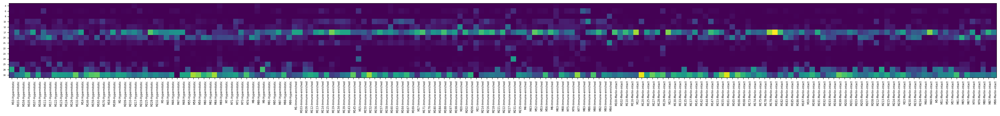

In [9]:
# Make heatplot of tumors X topics

topics_of_interest = [30,28,25,24,23,22,21,20,17,16,13,12,10,8,6,4,3,2,0]
displayedtopics = []
min_contribution = 0.01  # Filter för topics that don't contribute > min_contribution in any tumour
topicmask = [max(m[i,:]) >= min_contribution and i in topics_of_interest for i in range(m.shape[0]) ]
displayedtopics = np.arange(m.shape[0])[topicmask]
topicXtumor_data = m[topicmask,:][:,loomorder]
ndisplayedtopics = len(displayedtopics)
print("Topics after filter: %s" % ndisplayedtopics)
sum_per_tumor = np.sum(topicXtumor_data, axis=0)
topicXtumor_data = topicXtumor_data / sum_per_tumor   # Normalize to 1.0 per tumor
fig, ax = plt.subplots(figsize=(40,40))
im = ax.imshow(topicXtumor_data)
midtype_ordered = [ m[0] + "-" + m[1] for m in metadata_ordered ]
ax.set_xticks(np.arange(len(midtype_ordered)), labels=midtype_ordered, size=5)
ax.set_yticks(np.arange(len(displayedtopics)), labels=displayedtopics, size=5)
plt.setp(ax.get_xticklabels(), rotation=90, ha="right", rotation_mode="anchor", fontsize=6)
plt.show()

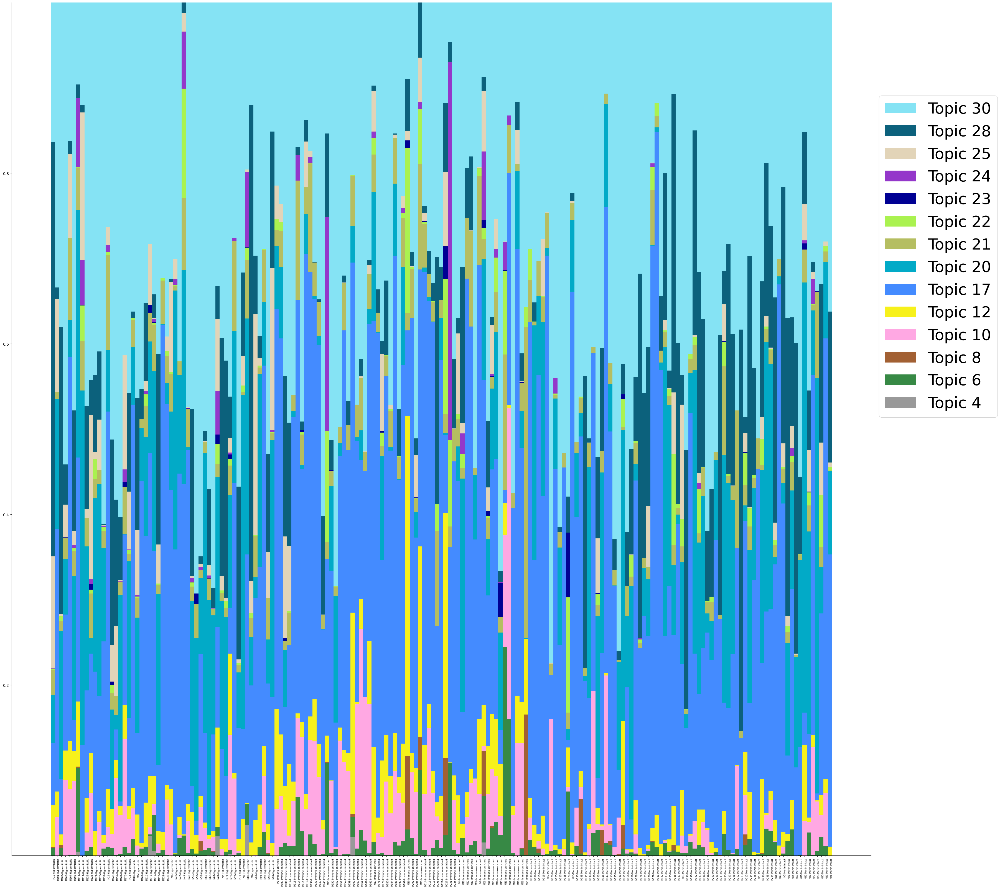

In [10]:
# Multi-barplot of topic contributions on each tumor
colors = ['#999999','#378945','#A26033','#ffa8e3','#f7f11b','#448BFF','#02aac7','#B5BE61','#AAF250','#000093','#9437CA','#e2d4b8','#0c617c','#85E3F4']
width = 1
fig, ax = plt.subplots(figsize=(40,40))
bottom = np.zeros(ntypes)
topicids = [ 'Topic %s' % i for i in displayedtopics ]

for i in range(ndisplayedtopics):
    layer = topicXtumor_data[i,:]
    p = ax.bar(midtype_ordered, layer, width, bottom=bottom, color=colors[i])
    bottom += layer

plt.setp(ax.get_xticklabels(), rotation=90, ha="right", rotation_mode="anchor", fontsize=6)
plt.legend(topicids, bbox_to_anchor=(1., 0., 0., 0.9), reverse=True, prop={'size':40})
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

#plt.savefig('/proj/meninges/Topic_modelling/plots/bulk_topics_alltumors.png',dpi=300)
plt.show()

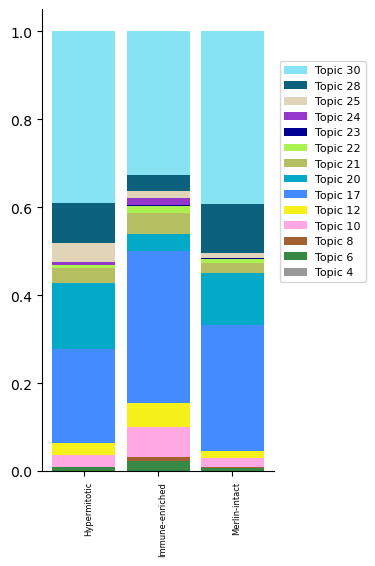

In [47]:
# Multi-barplot of average topic contributions per tumor type
colors = ['#999999','#378945','#A26033','#ffa8e3','#f7f11b','#448BFF','#02aac7','#B5BE61','#AAF250','#000093','#9437CA','#e2d4b8','#0c617c','#85E3F4']

tumortypes = np.array([m[1] for m in metadata_ordered])
uniquetumortypes = np.unique(tumortypes)
nuniquetumortypes = len(uniquetumortypes)
width = 0.85
fig, ax = plt.subplots(figsize=(3,6))
topicids = [ 'Topic %s' % i for i in displayedtopics ]

bottom = np.zeros(nuniquetumortypes)
topicXtype_means = np.zeros([ndisplayedtopics, nuniquetumortypes], dtype='float')

for i, t in enumerate(uniquetumortypes):
    means =  np.mean(topicXtumor_data[:,tumortypes==t], axis=1)
    topicXtype_means[:,i] = means

for topic_idx in range(ndisplayedtopics):
    layer = topicXtype_means[topic_idx,:]
    p = ax.bar(uniquetumortypes, layer, width, bottom=bottom, color=colors[topic_idx])
    bottom += layer

plt.setp(ax.get_xticklabels(), rotation=90, ha="right", rotation_mode="anchor", fontsize=6)
plt.legend(topicids, bbox_to_anchor=(1., 0., 0., 0.9), reverse=True, prop={'size':8})

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

#plt.savefig('/proj/meninges/Topic_modelling/plots/bulk_topics_tumortypes.pdf',dpi=300)
plt.show()

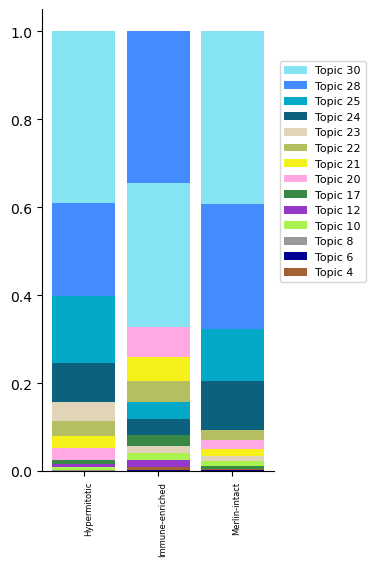

In [16]:
# Multi-barplot of average topic contributions per tumor type
colors = ['#999999','#378945','#A26033','#ffa8e3','#f7f11b','#448BFF','#02aac7','#B5BE61','#AAF250','#000093','#9437CA','#e2d4b8','#0c617c','#85E3F4']

tumortypes = np.array([m[1] for m in metadata_ordered])
uniquetumortypes = np.unique(tumortypes)
nuniquetumortypes = len(uniquetumortypes)
width = 0.85
fig, ax = plt.subplots(figsize=(3,6))
topicids = [ 'Topic %s' % i for i in displayedtopics ]

bottom = np.zeros(nuniquetumortypes)
topicXtype_means = np.zeros([ndisplayedtopics, nuniquetumortypes], dtype='float')

# Calculate the mean contributions per tumor type
for i, t in enumerate(uniquetumortypes):
    means =  np.mean(topicXtumor_data[:,tumortypes==t], axis=1)
    topicXtype_means[:,i] = means

# Sort topics for each tumor type in descending order of their means
sorted_indices = np.argsort(topicXtype_means, axis=0)  # Sorting in descending order for each tumor type

# Plot the bars in the sorted order
for j in range(nuniquetumortypes):  # Iterate over each tumor type
    bottom_j = 0  # Reset the bottom for each tumor type
    for i in sorted_indices[:, j]:  # Iterate over topics in sorted order
        layer = topicXtype_means[i, j]
        p = ax.bar(uniquetumortypes[j], layer, width, bottom=bottom_j, color=colors[i])
        bottom_j += layer

plt.setp(ax.get_xticklabels(), rotation=90, ha="right", rotation_mode="anchor", fontsize=6)
plt.legend(topicids, bbox_to_anchor=(1., 0., 0., 0.9), reverse=True, prop={'size':8})

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

#plt.savefig('/proj/meninges/Topic_modelling/plots/bulk_topics_tumortypes_ascending.pdf',dpi=300)
plt.show()